In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
from tqdm import tqdm
import shutil as sh

用滑动窗口的方式，先使用分类识别出需要检测的目标，再使用回归将窗口调整为和被检测的目标一样的大小
https://yiyan.baidu.com/share/F9YWF5EXtB 

In [2]:
!python3 --version

Python 3.11.11


In [3]:
!pip install --no-index --find-links=/kaggle/input/d/binghualiu/package/whl ultralytics ensemble_boxes

Looking in links: /kaggle/input/d/binghualiu/package/whl
Processing /kaggle/input/d/binghualiu/package/whl/ultralytics-8.3.144-py3-none-any.whl
Processing /kaggle/input/d/binghualiu/package/whl/ensemble_boxes-1.0.9-py3-none-any.whl
Processing /kaggle/input/d/binghualiu/package/whl/ultralytics_thop-2.0.14-py3-none-any.whl (from ultralytics)
INFO: pip is looking at multiple versions of torch to determine which version is compatible with other requirements. This could take a while.
Processing /kaggle/input/d/binghualiu/package/whl/torch-2.7.0-cp311-cp311-manylinux_2_28_x86_64.whl (from ultralytics)
Processing /kaggle/input/d/binghualiu/package/whl/sympy-1.14.0-py3-none-any.whl (from torch>=1.8.0->ultralytics)
Processing /kaggle/input/d/binghualiu/package/whl/nvidia_cuda_nvrtc_cu12-12.6.77-py3-none-manylinux2014_x86_64.whl (from torch>=1.8.0->ultralytics)
Processing /kaggle/input/d/binghualiu/package/whl/nvidia_cuda_runtime_cu12-12.6.77-py3-none-manylinux2014_x86_64.manylinux_2_17_x86_64.w

In [4]:
from ultralytics import YOLO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# 获取 yolov5 代码库

In [5]:
weight='/kaggle/input/exp1x_100_best_0929/pytorch/default/1/exp1x_100_best_0929.pt'

In [6]:
#!git clone https://github.com/ultralytics/yolov5
#!mv yolov5/* ./

!cp -r ../input/yolov5train/* .

In [7]:
!pip install --no-deps '../input/weightedboxesfusion/' > /dev/null

  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for ensemble_boxes
ERROR: ERROR: Failed to build installable wheels for some pyproject.toml based projects (ensemble_boxes)


In [8]:
df = pd.read_csv('../input/global-wheat-detection/train.csv')
bboxs = np.stack(df['bbox'].apply(lambda x: np.fromstring(x[1:-1], sep=',')))
for i, column in enumerate(['x', 'y', 'w', 'h']):
    df[column] = bboxs[:,i]
    #enumerate(['x', 'y', 'w', 'h'])用于遍历列名列表，并将bbox数组中的对应列值分配给新的DataFrame列
df.drop(columns=['bbox'], inplace=True)
df['x_center'] = df['x'] + df['w']/2
df['y_center'] = df['y'] + df['h']/2
df['classes'] = 0
#由于只检测一种物体（小麦），所以所有标签都设置为0
df = df[['image_id','x', 'y', 'w', 'h','x_center','y_center','classes']]
#重新排序并选择DataFrame的某些列，得到一个新的DataFrame，只包含指定的列

In [9]:
df.head()

,image_id,x,y,w,h,x_center,y_center,classes
0,b6ab77fd7,834.0,222.0,56.0,36.0,862.0,240.0,0
1,b6ab77fd7,226.0,548.0,130.0,58.0,291.0,577.0,0
2,b6ab77fd7,377.0,504.0,74.0,160.0,414.0,584.0,0
3,b6ab77fd7,834.0,95.0,109.0,107.0,888.5,148.5,0
4,b6ab77fd7,26.0,144.0,124.0,117.0,88.0,202.5,0


In [10]:
index = list(set(df.image_id))

# Convert train data to yolov5 format
Based on [this notebook](https://www.kaggle.com/orkatz2/yolov5-train)

In [11]:
def convertTrainLabel():
    source = 'train'
    if True:
        for fold in [0]:
            val_index = index[len(index)*fold//5:len(index)*(fold+1)//5]
            #len(index)*fold//5 计算出验证集的起始索引，len(index)*(fold+1)//5 计算出验证集的结束索引
            #除以5是为了将数据集分成5份，进行5折交叉验证。每次交叉验证会将数据集分成5份，其中4份用作训练集，1份用作验证集。
            for name,mini in tqdm(df.groupby('image_id')):
            #使用df.groupby('image_id')对数据集进行分组，name表示分组的名称，mini表示分组的数据。
            #遍历每个分组，如果name在val_index中，将path2save设为'val2017/'，否则设为'train2017/'。
                if name in val_index:
                    path2save = 'val2017/'
                else:
                    path2save = 'train2017/'
                if not os.path.exists('convertor/fold{}/labels/'.format(fold)+path2save):
                    os.makedirs('convertor/fold{}/labels/'.format(fold)+path2save)
                 #检查是否存在文件夹'convertor/fold{}/labels/'.format(fold)+path2save，如果不存在，则创建该文件夹。
            #根据索引，数据集被分为训练集和验证集。对于每个image_id，根据其是否在val_index中来确定它应该被放在哪个集合中
                with open('convertor/fold{}/labels/'.format(fold)+path2save+name+".txt", 'w+') as f:
                    row = mini[['classes','x_center','y_center','w','h']].astype(float).values
                    row = row/1024
                    row = row.astype(str)
                    for j in range(len(row)):
                        text = ' '.join(row[j])
                        f.write(text)
                        f.write("\n")
                #对于每个image_id，其相关的标签数据（类别、中心坐标、宽度和高度）被提取出来，除以1024进行归一化，然后保存为文本文件。每个小麦的标签占一行，格式是class x_center y_center width height。
                if not os.path.exists('convertor/fold{}/images/{}'.format(fold,path2save)):
                    os.makedirs('convertor/fold{}/images/{}'.format(fold,path2save))
                    # #检查是否存在文件夹'convertor/fold{}/labels/'.format(fold)+path2save，如果不存在，则创建该文件夹。
                sh.copy("../input/global-wheat-detection/{}/{}.jpg".format(source,name),'convertor/fold{}/images/{}/{}.jpg'.format(fold,path2save,name))
                #最后，图像文件从原始位置复制到相应的训练和验证文件夹中。

In [12]:
def convert_yolo_to_submission(predictions, image_id, original_size):
    """Convert YOLO predictions to submission format
    
    Format: image_id,confidence x y width height [confidence x y width height ...]
    Example: ce4833752,0.5 0 0 100 100
    Multiple boxes: 1da9078c1,0.3 0 0 50 50 0.5 10 10 30 30
    Empty prediction: 6ca7b2650,
    """
    if len(predictions) == 0:
        return f"{image_id},"
    
    original_width, original_height = original_size
    boxes = []
    
    for pred in predictions:
        # 获取置信度
        conf = pred.conf.item()
        
        # 获取归一化的边界框坐标（xywh格式）
        x_center, y_center, width, height = pred.xywhn[0][:4].tolist()
        
        # 转换为原始图像像素坐标（左上角格式）
        x = max(0, int((x_center - width/2) * original_width))
        y = max(0, int((y_center - height/2) * original_height))
        w = int(width * original_width)
        h = int(height * original_height)
        
        # 格式化为整数坐标
        boxes.append(f"{conf:.1f} {x} {y} {w} {h}")
    
    return f"{image_id},{' '.join(boxes)}"

In [13]:
from ensemble_boxes import weighted_boxes_fusion
#用于合并重叠的边界框
def run_wbf(boxes, scores, image_size=1023, iou_thr=0.5, skip_box_thr=0.7, weights=None):
    
    labels = [np.zeros(score.shape[0]) for score in scores]
    #初始化一个与 scores 列表长度相同的 labels 列表，其中每个元素都是一个全零的NumPy数组，其长度与对应 score 数组的长度相同。
    boxes = [box/(image_size) for box in boxes]
    #将 boxes 列表中的每个边界框坐标除以 image_size，以将其标准化到0到1的范围内
    boxes, scores, labels = weighted_boxes_fusion(boxes, scores, labels, weights=None, iou_thr=iou_thr, skip_box_thr=skip_box_thr)
    #调用 weighted_boxes_fusion 函数，传入标准化后的边界框、分数、标签和可选的权重。这个函数将执行加权边界框融合，并返回融合后的边界框、分数和标签。
    boxes = boxes*(image_size)
    #将融合后的边界框坐标乘以 image_size，以将其转换回原始像素空间。
    return boxes, scores, labels
    #返回融合后的边界框、分数和标签
#分数通常指的是检测框的置信度分数，分数越高，表示模型越确信检测框内的内容符合某一类别的物体
    
#处理图像旋转时的边界框变换时非常有用，尤其是在使用测试时增强（TTA）技术时，需要确保边界框与旋转后的图像保持一致。
def TTAImage(image, index):
    image1 = image.copy()
    #创建了一个image的副本，命名为image1，这样在后续处理中不会修改原始的image
    if index==0: 
        rotated_image = cv2.rotate(image1, cv2.ROTATE_90_CLOCKWISE)
        return rotated_image
    #如果index为0，它将image1顺时针旋转90度，并返回旋转后的图像。
    elif index==1:
        rotated_image2 = cv2.rotate(image1, cv2.ROTATE_90_CLOCKWISE)
        rotated_image2 = cv2.rotate(rotated_image2, cv2.ROTATE_90_CLOCKWISE)
        return rotated_image2
    #如果index为1，它首先将image1顺时针旋转90度，然后再将结果顺时针旋转90度（总共旋转180度），并返回旋转后的图像。
    elif index==2:
        rotated_image3 = cv2.rotate(image1, cv2.ROTATE_90_CLOCKWISE)
        rotated_image3 = cv2.rotate(rotated_image3, cv2.ROTATE_90_CLOCKWISE)
        rotated_image3 = cv2.rotate(rotated_image3, cv2.ROTATE_90_CLOCKWISE)
        return rotated_image3
    #如果index为2，它首先将image1顺时针旋转90度，然后将结果再顺时针旋转90度，接着将再次旋转后的结果顺时针旋转90度（总共旋转270度），并返回旋转后的图像。
    elif index == 3:
        return image1
    #如果index为3，它直接返回原始的image1，不进行任何旋转。
    
    
    
#确保了在旋转图像后，边界框也相应地进行了旋转，并且坐标仍然位于正确的位置。
def rotBoxes90(boxes, im_w, im_h):
    ret_boxes =[]
    #创建了一个空列表ret_boxes，用于存储旋转后的边界框坐标
    for box in boxes:
        x1, y1, x2, y2 = box
        x1, y1, x2, y2 = x1-im_w//2, im_h//2 - y1, x2-im_w//2, im_h//2 - y2
        #将边界框的坐标从图像坐标系转换为以图像中心为原点的坐标系。这样做是为了方便进行后续的旋转操作。这里通过减去图像宽度的一半和图像高度的一半来实现坐标变换。
        x1, y1, x2, y2 = y1, -x1, y2, -x2
        #对边界框的坐标进行90度的顺时针旋转
        x1, y1, x2, y2 = int(x1+im_w//2), int(im_h//2 - y1), int(x2+im_w//2), int(im_h//2 - y2)
        #将旋转后的坐标从以图像中心为原点的坐标系转换回图像坐标系。
        x1a, y1a, x2a, y2a = min(x1, x2), min(y1, y2), max(x1, x2), max(y1, y2)
        #为了确保边界框的坐标是有序的（即左上角坐标在左上角，右下角坐标在右下角），这里使用min和max函数重新计算(x1, y1)和(x2, y2)。
        ret_boxes.append([x1a, y1a, x2a, y2a])
        #将调整后的边界框坐标添加到ret_boxes列表中。
    return np.array(ret_boxes)
    #将ret_boxes列表转换为NumPy数组，并返回

    
#使用给定的深度学习模型对单个图像进行物体检测，并返回检测到的物体的边界框坐标和对应的置信度。
def detect1Image(im0, imgsz, model, device, conf_thres, iou_thres):
    #im0：原始图像。imgsz：目标图像大小，模型输入所需的大小。model：预训练的深度学习模型。device：模型运行在哪个设备上，例如 'cuda' 或 'cpu'。conf_thres：置信度阈值，用于过滤低置信度的检测结果。iou_thres：IoU阈值，用于非极大值抑制（NMS）。
    img = letterbox(im0, new_shape=imgsz)[0]
    img = img[:, :, ::-1].transpose(2, 0, 1)  # BGR to RGB, to 3x416x416
    img = np.ascontiguousarray(img)
    #使用`letterbox`函数调整图像大小到`imgsz`，同时保持图像的宽高比。将图像从BGR格式转换为RGB格式，并改变其维度顺序以匹配模型的输入格式。确保图像数据是连续的，这对于后续转换为PyTorch张量很重要。

    img = torch.from_numpy(img).to(device)
    img =  img.float()  # uint8 to fp16/32
    img /= 255.0  
    #将图像从NumPy数组转换为PyTorch张量。  将图像数据从uint8格式转换为float格式。将图像的像素值归一化到0-1范围。
    if img.ndimension() == 3:
        img = img.unsqueeze(0)
    #如果图像是一个三维张量（HxWxC），则增加一个额外的维度使其成为一个四维张量（1xHxWxC），这是大多数深度学习模型所期望的输入格式。
    # Inference
    # pred = model(img, augment=False)[0]
    results = model.predict(
        source=img,
        conf=0.3,
        imgsz=1024,  # 使用相同的输入尺寸
        verbose=False,
        # save=True,
        # name=f'{image_id}_pred',
        nms=True,
        agnostic_nms=True,
    )

    pred = results[0].boxes
    # print(results[0].boxes.xywhn)
    #使用预处理后的图像作为输入，对模型进行推理，得到检测结果。
    # Apply NMS
    # pred = non_max_suppression(pred, conf_thres, iou_thres)
    #使用NMS处理检测结果，去除重叠度较高的检测框，只保留置信度较高的框
    boxes = []
    scores = []
    # for i, det in enumerate(pred):  # detections per image
    #     # save_path = 'draw/' + image_id + '.jpg'
    #     if det is not None and len(det):
    #         det[:, :4] = scale_coords(img.shape[2:], det[:, :4], im0.shape).round()
    #         for *xyxy, conf, cls in det:
    #             boxes.append([int(xyxy[0]), int(xyxy[1]), int(xyxy[2]), int(xyxy[3])])
    #             scores.append(conf.cpu())
    # #遍历每个检测结果。  如果检测结果不为空，则将其坐标从模型输入大小缩放到原始图像大小。 提取每个检测框的坐标和置信度，并分别添加到`boxes`和`scores`列表中

    for i in pred:
        x_center, y_center, width, height = i.xywh[0][:4].tolist()
        x = max(0, (x_center - width/2) )
        y = max(0, (y_center - height/2))
        w = width 
        h = height 
        x1, y1, x2, y2 = x, y, x+w, y+h
        boxes.append([int(x1), int(y1), int(x2), int(y2)])
        scores.append(i.conf.item())
    

    return np.array(boxes), np.array(scores) 
   #将边界框和置信度转换为NumPy数组并返回。

# Make pseudo labels for Yolov5

In [14]:
from utils.datasets import *
from utils.utils import *

def makePseudolabel():
    source = '../input/global-wheat-detection/test/'
    # weights = 
    imgsz = 1024
    conf_thres = 0.5
    iou_thres = 0.6
    is_TTA = True
    
    imagenames =  os.listdir(source)
    
    device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

    # Load model
    # model = torch.load(weights, map_location=device)['model'].float()  # load to FP32
    model = YOLO(weight)
    # model.to(device).eval()
    
    dataset = LoadImages(source, img_size=imgsz)

    path2save = 'train2017/'
    if not os.path.exists('convertor/fold0/labels/'+path2save):
        os.makedirs('convertor/fold0/labels/'+path2save)
    if not os.path.exists('convertor/fold0/images/{}'.format(path2save)):
        os.makedirs('convertor/fold0/images/{}'.format(path2save))
            
    for name in imagenames:
        image_id = name.split('.')[0]
        im01 = cv2.imread('%s/%s.jpg'%(source,image_id))  # BGR
        if im01.shape[0]!=1024 or im01.shape[1]!=1024:
            continue
        assert im01 is not None, 'Image Not Found '
        # Padded resize
        im_w, im_h = im01.shape[:2]
        if is_TTA:
            enboxes = []
            enscores = []
            for i in range(4):
                im0 = TTAImage(im01, i)
                boxes, scores = detect1Image(im0, imgsz, model, device, conf_thres, iou_thres)
                for _ in range(3-i):
                    boxes = rotBoxes90(boxes, im_w, im_h)
                    
                enboxes.append(boxes)
                enscores.append(scores) 

            boxes, scores, labels = run_wbf(enboxes, enscores, image_size = im_w, iou_thr=0.6, skip_box_thr=0.43)
            boxes = boxes.astype(np.int32).clip(min=0, max=im_w)
        else:
            boxes, scores = detect1Image(im01, imgsz, model, device, conf_thres, iou_thres)

        boxes[:, 2] = boxes[:, 2] - boxes[:, 0]
        boxes[:, 3] = boxes[:, 3] - boxes[:, 1]
        
        boxes = boxes[scores >= 0.05].astype(np.int32)
        scores = scores[scores >=float(0.05)]
        
        lineo = ''
        for box in boxes:
            x1, y1, w, h = box
            xc, yc, w, h = (x1+w/2)/1024, (y1+h/2)/1024, w/1024, h/1024
            lineo += '0 %f %f %f %f\n'%(xc, yc, w, h)
            
        fileo = open('convertor/fold0/labels/'+path2save+image_id+".txt", 'w+')
        fileo.write(lineo)
        fileo.close()
        sh.copy("../input/global-wheat-detection/test/{}.jpg".format(image_id),'convertor/fold0/images/{}/{}.jpg'.format(path2save,image_id))
            


In [15]:
convertTrainLabel()

100%|██████████| 3373/3373 [00:37<00:00, 89.43it/s]


In [16]:
makePseudolabel()

In [17]:
!pwd

/kaggle/working


# Retrain yolov5 with pseudo data

In [18]:
print(weight)


/kaggle/input/exp1x_100_best_0929/pytorch/default/1/exp1x_100_best_0929.pt


In [19]:
if len(os.listdir('../input/global-wheat-detection/test/'))<11:
    pass
    #!python train.py --img 1024 --batch 4 --epochs 1 --data ../input/configyolo5/wheat0.yaml --cfg ../input/yolov5/v5/v5/models/yolov5x.yaml  --weights ../input/yolov5/bestv4.pt   
else:
    # !python /kaggle/input/pl-train/pl_train.py --batch_size 4 --epochs 10 --data_yaml /kaggle/input/mywheat0yml/wheat0.yaml --ckpt '/kaggle/input/exp1x_bigdata_best/pytorch/default/1/exp1x_bigdata_best.pt'
    hyper_params = {
        'optimizer': 'AdamW',
        'cos_lr': True,
        # 優化器參數
        'lr0': 0.001,
        # 'lrf': 0.12,
        # 'momentum': 0.843,
        # 'weight_decay': 0.00036,
        
        # # 熱身階段配置
        # 'warmup_epochs': 2.0,
        # 'warmup_momentum': 0.5,
        # 'warmup_bias_lr': 0.05,
        
        # 損失函數權重
        'box': 0.0296,
        'cls': 0.243,
    
        # 數據增強參數
        'hsv_h': 0.0138,
        'hsv_s': 0.664,
        'hsv_v': 0.464,
        'degrees': 0.373,
        'translate': 0.245,
        'scale': 0.898,
        'shear': 0.602,
        'perspective': 0.0,
        'flipud': 0.5,
        'fliplr': 0.5,
        
        # 進階增強策略
        'mosaic': 1.0,
        'mixup': 0.3
    }

    # print(f"使用的模型: {weith}")
    model = YOLO(weight)
    # 訓練配置
    results = model.train(
        data='/kaggle/input/mywheat0yml/wheat0.yaml',
        epochs=10,
        imgsz=1024,
        batch=2,
        device='0',  # 使用 GPU
        project='yolo_train_results',
        name='123',
        **hyper_params,
    )
    
    
!rm -rf convertor

# Final prediction

In [20]:
def detect():
    source = '../input/global-wheat-detection/test/'
    # weights = '/kaggle/input/12n_05250307/pytorch/default/1/12n_05250307.pt'
    # if not os.path.exists(weights):
    #     weights = '/kaggle/input/12n_05250307/pytorch/default/1/12n_05250307.pt'
    imgsz = 1024
    conf_thres = 0.5
    iou_thres = 0.6
    is_TTA = True
    
    imagenames =  os.listdir(source)
    
    device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

    # Load model
    # model = torch.load(weights, map_location=device)['model'].float()  # load to FP32
    model = YOLO(weight)
    # model.to(device).eval()
    
    dataset = LoadImages(source, img_size=imgsz)

    results = []
    fig, ax = plt.subplots(5, 2, figsize=(30, 70))
    count = 0
    # img = torch.zeros((1, 3, imgsz, imgsz), device=device)  # init img
    #for path, img, im0s, _ in dataset:
    for name in imagenames:
        image_id = name.split('.')[0]
        im01 = cv2.imread('%s/%s.jpg'%(source,image_id))  # BGR
        assert im01 is not None, 'Image Not Found '
        # Padded resize
        im_w, im_h = im01.shape[:2]
        if is_TTA:
            enboxes = []
            enscores = []
            for i in range(4):
                im0 = TTAImage(im01, i)
                boxes, scores = detect1Image(im0, imgsz, model, device, conf_thres, iou_thres)
                for _ in range(3-i):
                    boxes = rotBoxes90(boxes, im_w, im_h)
                    
                if 1: #i<3:
                    enboxes.append(boxes)
                    enscores.append(scores) 
            boxes, scores = detect1Image(im01, imgsz, model, device, conf_thres, iou_thres)
            enboxes.append(boxes)
            enscores.append(scores)

            boxes, scores, labels = run_wbf(enboxes, enscores, image_size = im_w, iou_thr=0.6, skip_box_thr=0.5)
            boxes = boxes.astype(np.int32).clip(min=0, max=im_w)
        else:
            boxes, scores = detect1Image(im01, imgsz, model, device, conf_thres, iou_thres)

        boxes[:, 2] = boxes[:, 2] - boxes[:, 0]
        boxes[:, 3] = boxes[:, 3] - boxes[:, 1]
        
        boxes = boxes[scores >= 0.05].astype(np.int32)
        scores = scores[scores >=float(0.05)]
        if count<10:
            #sample = image.permute(1,2,0).cpu().numpy()
            for box, score in zip(boxes,scores):
                cv2.rectangle(im0,
                              (box[0], box[1]),
                              (box[2]+box[0], box[3]+box[1]),
                              (220, 0, 0), 2)
                cv2.putText(im0, '%.2f'%(score), (box[0], box[1]), cv2.FONT_HERSHEY_SIMPLEX ,  
                   0.5, (255,255,255), 2, cv2.LINE_AA)
            ax[count%5][count//5].imshow(im0)
            count+=1
            
        result = {
            'image_id': image_id,
            'PredictionString': format_prediction_string(boxes, scores)
        }

        results.append(result)
    return results

In [21]:
def format_prediction_string(boxes, scores):
    pred_strings = []
    for j in zip(scores, boxes):
        pred_strings.append("{0:.4f} {1} {2} {3} {4}".format(j[0], j[1][0], j[1][1], j[1][2], j[1][3]))

    return " ".join(pred_strings)

,image_id,PredictionString
0,796707dd7,0.7891 710 826 107 98 0.7891 942 67 81 110 0.7...
1,2fd875eaa,0.8363 533 868 107 120 0.8282 1 0 107 73 0.827...
2,cc3532ff6,0.8570 769 826 166 166 0.8329 72 799 143 177 0...
3,53f253011,0.8417 928 800 95 221 0.8406 464 461 151 207 0...
4,f5a1f0358,0.8373 944 434 79 186 0.8301 134 749 164 122 0...


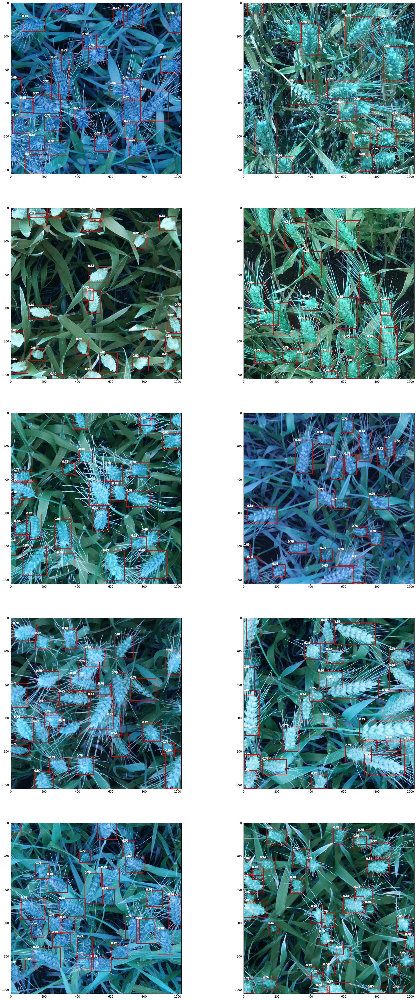

In [22]:
results = detect()
test_df = pd.DataFrame(results, columns=['image_id', 'PredictionString'])
test_df.to_csv('submission.csv', index=False)
test_df.head()